# Single Cell Sequencing
## Gene exploration


Uses exon data extracted from: zUMIs_output\expression\*.dgecounts.rds and gene data from: zUMIs_output\expression\*.gene_names.txt<br>


In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scipy
import anndata as ad
import hdf5plugin
from sklearn.decomposition import TruncatedSVD
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import rcParams
import os 
#external modules
#pretty plotting
import seaborn as sb
import sys 
import warnings
warnings.filterwarnings("ignore")
sb.set_context(context='poster')

import copy

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80)

scanpy==1.9.3 anndata==0.9.2 umap==0.5.3 numpy==1.24.4 scipy==1.10.1 pandas==2.0.3 scikit-learn==1.3.0 statsmodels==0.14.0 python-igraph==0.10.6 louvain==0.8.1 pynndescent==0.5.10


## Data loading


In [3]:
figure_path = r'C:\Users\ilosz01\OneDrive - Linköpings universitet\MarcinLab\SingleCellSequencing\scs_analysis\figuresR'
input_path = r'C:\Users\ilosz01\OneDrive - Linköpings universitet\MarcinLab\SingleCellSequencing\scs_analysis\out'


adata_umap_path = os.path.join(input_path,'control_scs_umap_from_R.h5ad')
adata_path = os.path.join(input_path,'campari_scs_from_R.h5ad')


NO_PCA = 20
SELECTED_LOUVAIN = 'louvain_r1.5'


In [4]:
adata_all_path = os.path.join(input_path,'campari_scs_all_genes_from_R.h5ad')
adata_all = ad.read_h5ad(adata_all_path)

In [5]:
adata_umap = ad.read_h5ad(adata_umap_path)

## Explore Genes

In [6]:
### Define list of relevant genes 

marker_genes = ['Trpm3','Trpm2','Smr2','Sstr2','Bmpr1b','Trpm8','Trpv1','Piezo2','Piezo1','Nppb',
                'Sst','Pvalb','Prokr2','Mrgprd','Mrgpra3','Cd34',
                'Th','Trpa1','Ntrk3','Ntrk2','Ntrk1','Ret','Tac1','Calca','Calcb','Nefh',
                'S100b','Scn10a','Slc17a8','Atf3','Pou4f3','Calb1','Calb2','Avil','Asic3',
                'Asic2','Asic1','Pou6f2','Avpr1a','Pou4f2','Sox10','Casq2','Chrna7','Chrna3',
                'P2rx3','Gfra2','Ldhb','Necab2','Spp1','Adm','Hpse','Adra2a']

## Finding marker genes

In [ ]:
adata_umap

0-sample1-sample12-sample123-sample1234    2
1-sample1-sample12-sample123-sample1234    4
2-sample1-sample12-sample123-sample1234    3
4-sample1-sample12-sample123-sample1234    8
5-sample1-sample12-sample123-sample1234    4
                                          ..
379-sample5                                5
380-sample5                                2
381-sample5                                0
382-sample5                                6
383-sample5                                6
Name: louvain_r1.5, Length: 1706, dtype: category
Categories (16, object): ['0', '1', '2', '3', ..., '12', '13', '14', '15']

In [11]:
sc.pp.log1p(adata_umap) # it was already logaritmized but adata.uns['log1p'] has no 'base' key

In [12]:
adata_umap.uns['log1p']

{'base': None}

In [13]:
sc.tl.rank_genes_groups(adata_umap,SELECTED_LOUVAIN, use_raw=False, method='wilcoxon')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)


In [14]:
pd.DataFrame(adata_umap.uns['rank_genes_groups']['names']).head(10) # louvain_r2 has 0-12 clasters (column names are clusters)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,Mrgprd,Gm7271,Adcyap1,Negr1,Tbx3os2,Krt2,Mrgpra3,P2rx6,Asic3,Cacna1i,Pvalb,Ptprt,Gal,Skor2,Osmr,Ankrd52
1,Prkcq,Cd34,Gpx3,Mrap2,Baiap2l1,Gm27221,Mrgprx1,Lgi3,Abcg2,Tafa4,Pth1r,Rspo2,Trpv1,Kcnq3,Htr1f,Kcnh6
2,Rspo2,D130079A08Rik,Gal,Pcsk1,Cadps2,Mrgprb13,Tmprss11c,Syt2,Cgnl1,Wfdc2,Sh3bgr,Trpc3,C1qtnf7,Baiap2l1,Ptprk,Gm23935
3,Sdc1,Th,Trpv1,Esr1,Tbx3,Gm15681,Adora2b,Tesc,Serpinb1a,Zfp521,Relt,Rasa4,Cnr1,Tafa3,Gpr139,Ep300
4,Fam167a,Tafa4,Gfra3,Pou4f3,Upb1,Gm44063,Krt27,Syt3,Ly6h,P2ry1,Hs3st2,Prkcq,Adcyap1,Cadps2,Il31ra,Zfp521
5,Ptprt,Wfdc2,Tmem100,Rab3b,Vsnl1,Gm30198,Cfap61,Cabp7,Kcnip1,Kcnd3,Whrn,Dgki,Rxrg,Tmem163,Stom,Map3k9
6,9430021M05Rik,Gm47913,Atp2b4,Chst2,Lgi2,9330154J02Rik,Rspo1,Faim2,Gng8,Mmp17,Faim2,Hs6st2,Bex1,Tbx3os2,Pde4c,Foxo3
7,Gm765,Cdh9,Rxrg,Htr3a,Ntng1,Gm44603,Gda,Bcat1,Prkcb,Rasgrp1,Clec2l,Fam167a,Mrap2,Tmem108,Cysltr2,CT010467.2
8,Mmp25,Spink2,Kcnmb2,Atp2b4,Tmem28,Gm7558,Moxd1,Brinp1,F730043M19Rik,Myo1a,Slit2,Mrgprd,Kcnk3,Tpbgl,Ada,Sorbs2
9,Rab27b,Ighg2c,Npy1r,C1qtnf7,Tmem108,8030474K03Rik,Mical1,Clrn1,Serpinb1b,Slc12a7,Runx3,Ptprm,Gpx3,Kcnc4,Gstt2,Minar1


In [15]:
marker_genes_dict = {
    'RA-LTMR': ['Ntrk2'],
    'C-LTMR': ['Cd34', 'Th'],
    'Itch': ['Nppb','Mrgpra3'],
    'Nonpeptidergic-Nociceptors': ['Mrgprd'],
    'Peptidergic-Nociceptors': ['Sstr2'],
    'Interoceptors': ['Adra2a','Tac1'],
    'A-HTMR': ['Smr2','Bmpr1b'],
    'Propioceptores': ['Pvalb']
}

In [16]:
len(adata_umap.var_names)

16000

In [17]:
# there are some gene name duplicates
def unique(list1):
 
    # initialize a null list
    unique_list = []
    unique_index = []
 
    # traverse for all elements
    count = 0
    for x in list1:
        # check if exists in unique_list or not
        if x not in unique_list:
            unique_list.append(x)
            unique_index.append(count)
        count+=1
    return unique_list,unique_index
        
gene_name = []
for i in range(len(adata_umap.var['gene_name'])):
    gene_name.append(adata_umap.var['gene_name'].iloc[i])


In [18]:
# remove duplicates
unique_genes , unique_genes_index = unique(gene_name)

adata_umap = adata_umap[:,np.array(unique_genes_index)]

In [19]:
len(adata_umap.var_names)

15992

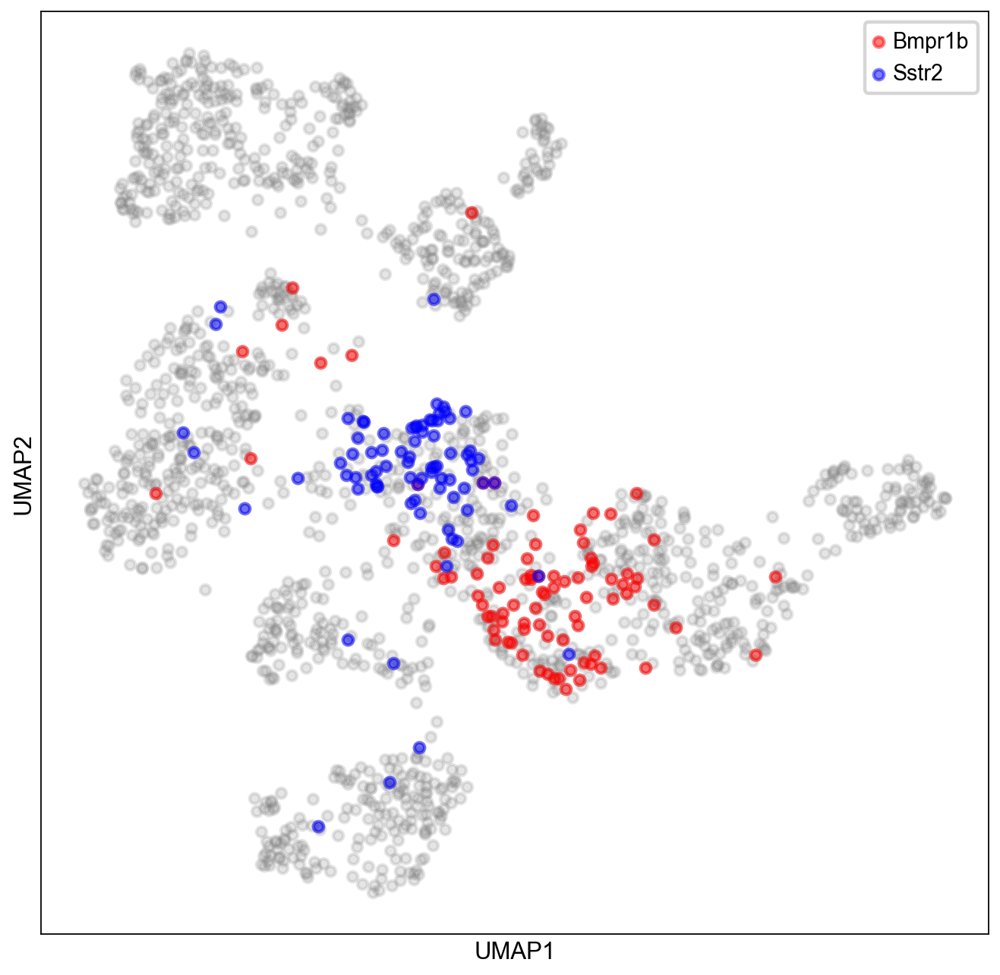

In [20]:
# show selected genes on same umap (each gene, different color)
genes2show = ['Bmpr1b','Sstr2']
# select colors for those genes
my_colors = ['r','b']
# select thresholds values for those genes (above which value to show them)
threshold = 1
figure, axes = plt.subplots()
# show umap as gray alpha dots
axes.scatter(adata_umap.obsm['X_umap'][:,0],adata_umap.obsm['X_umap'][:,1],c='gray',alpha=0.2)
for i in range(len(genes2show)):
    # normalized values for each gene at each point of umap representation
    my_gene_values = adata_umap.obs_vector(genes2show[i])
    # select which to show (use threshold)
    my_gene_indexes_above_threshold = np.where(my_gene_values > threshold)[0]
    axes.scatter(adata_umap.obsm['X_umap'][my_gene_indexes_above_threshold,0],adata_umap.obsm['X_umap'][my_gene_indexes_above_threshold,1],c=my_colors[i],alpha=0.5,label=genes2show[i])
axes.grid(False)
axes.legend()
figure.set_size_inches([10,10])    
# Hide X and Y axes tick marks
axes.set_xticks([])
axes.set_yticks([])
axes.set_xlabel('UMAP1')
axes.set_ylabel('UMAP2')
fig_title = ""
for g in genes2show:
    fig_title = fig_title+g+"_"
fig_title = fig_title+"above_"+str(threshold)
figure.savefig(os.path.join(figure_path, fig_title+'.png'))


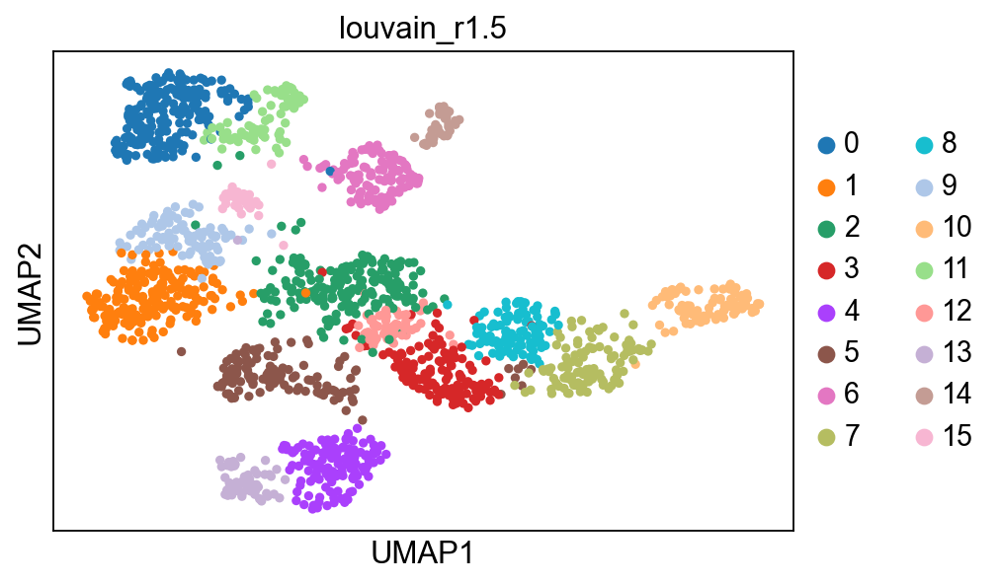

In [21]:
# show which claster is which
rcParams['figure.figsize']=(6,4)
sc.pl.umap(adata_umap, color=SELECTED_LOUVAIN, use_raw=False)

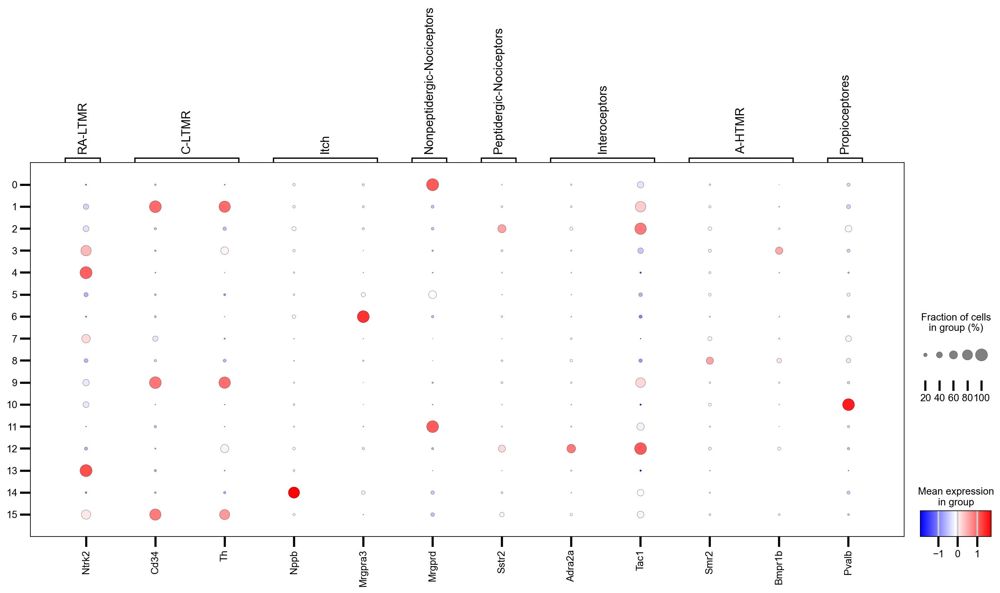

In [22]:

# show gene markers as dotplot
sc.pl.dotplot(adata_umap, marker_genes_dict, use_raw=False, groupby=SELECTED_LOUVAIN, cmap='bwr', figsize=(20,8))

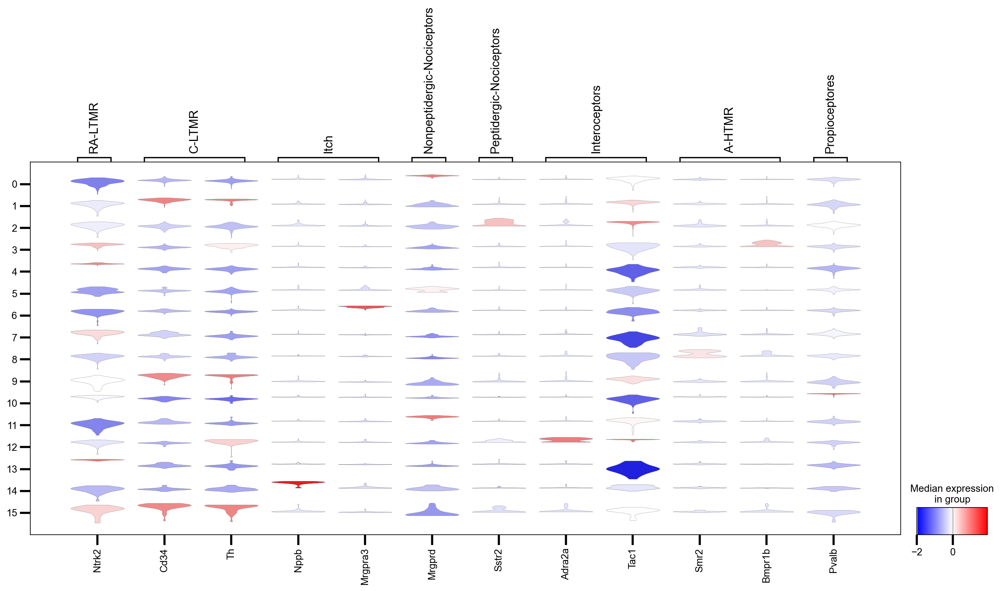

In [23]:
# show gene markers as violin plot
sc.pl.stacked_violin(adata_umap, marker_genes_dict, use_raw=False, groupby=SELECTED_LOUVAIN, cmap='bwr',figsize=(20,8),rotation=90)

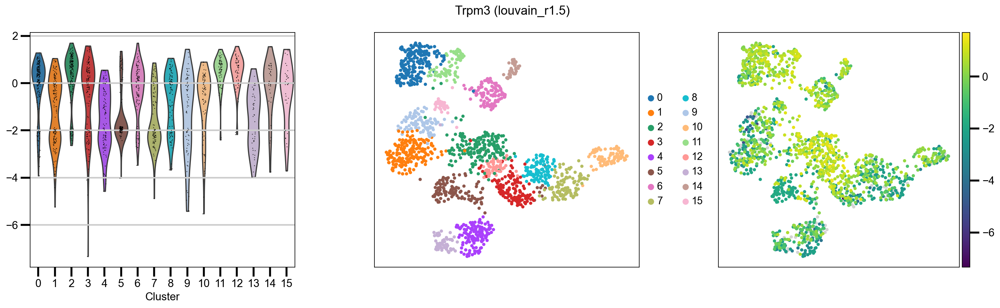

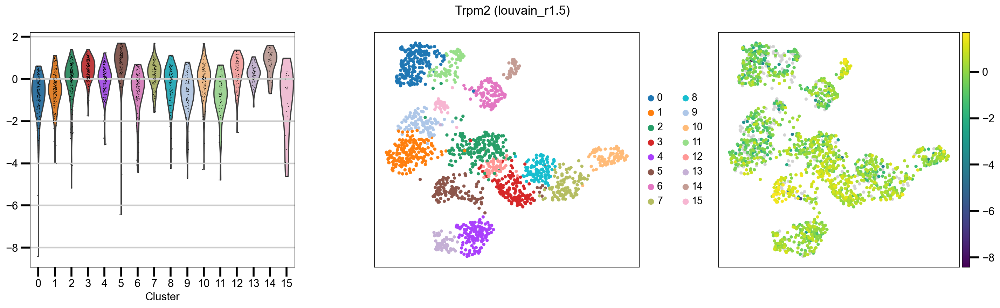

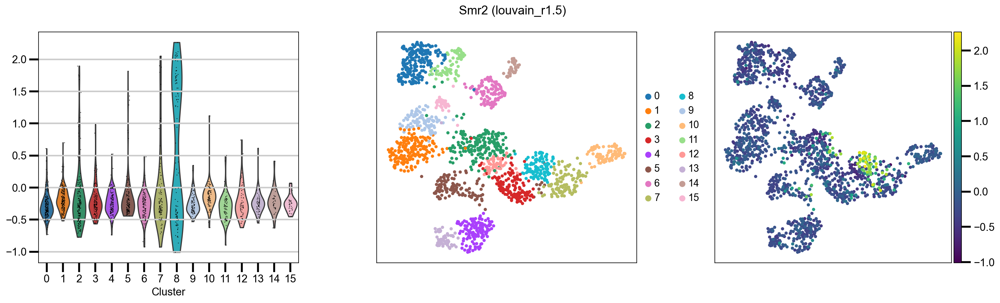

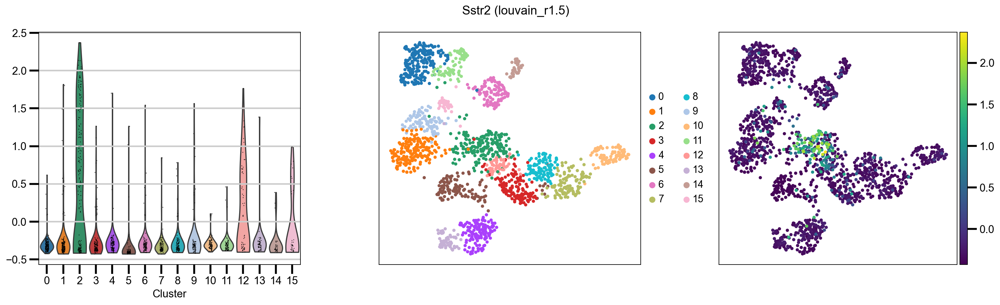

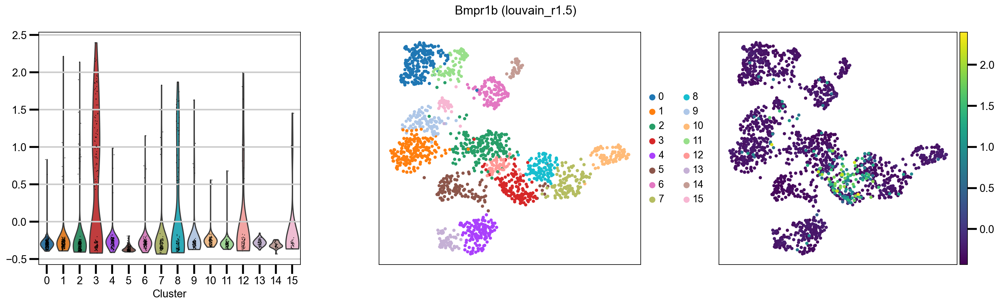

...

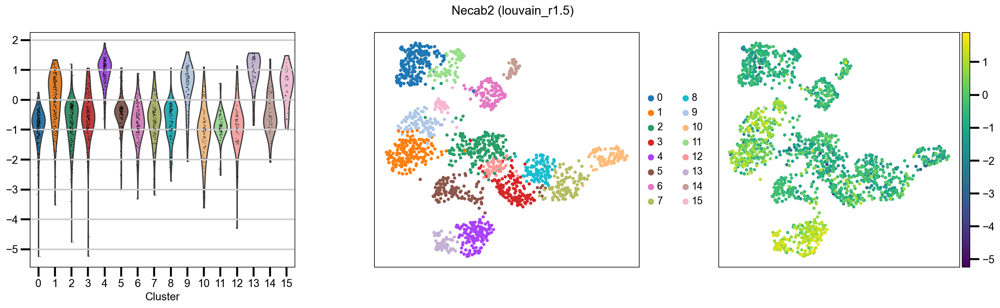

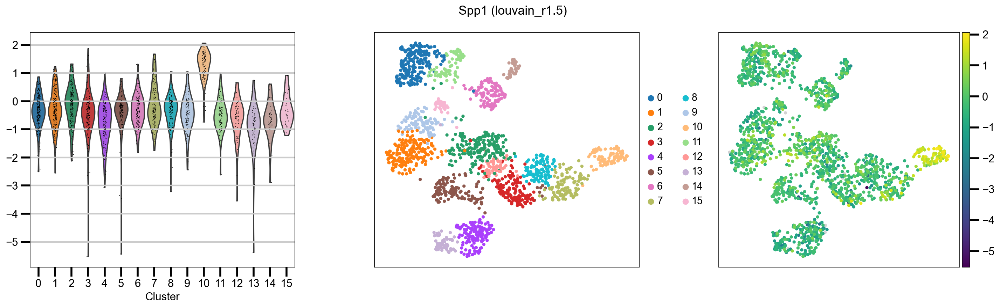

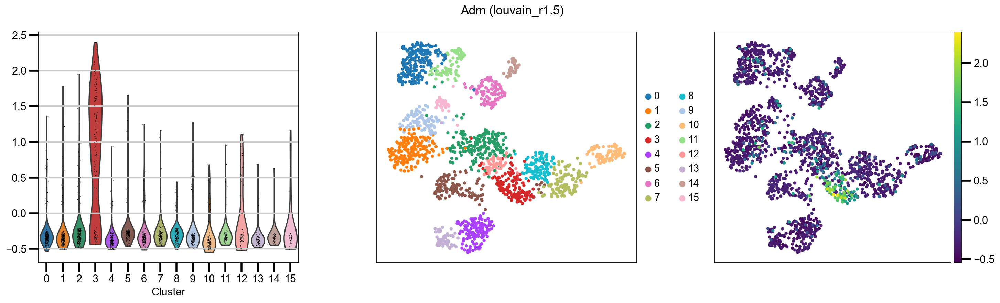

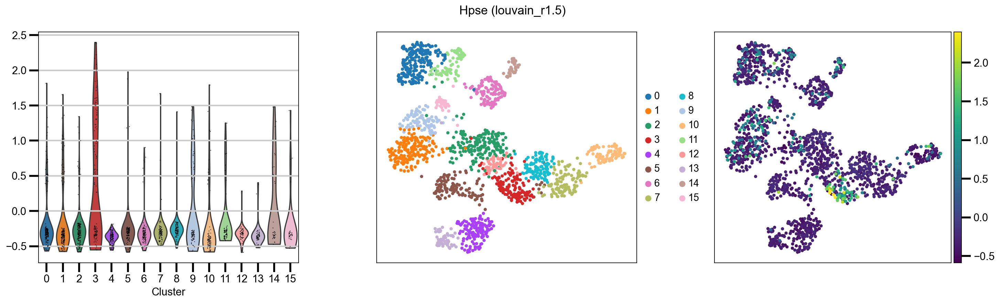

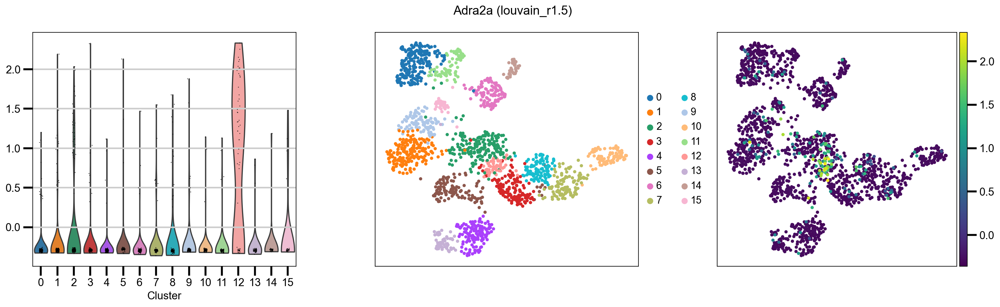

In [24]:
# for each gene, show 3 plots next to each other:
# 1) gene value distribution in each cluster (violin plot)
# 2) umap plot with clusters (to see where each cluster number is)
# 3) umap plot with gene value distribution in each cluster (values to colormap)
MY_LEFT = 0.09
MY_RIGHT = 0.9
MY_TOP = 0.9
MY_BOTTOM = 0.2
MY_WSPACE = 0.3
MY_HSPACE = 0.5
# Show violin plots next to clasters
# compare a certain gene across clasters
for gene in marker_genes:
    # This produces two Axes objects in a single Figure
    ncols=3
    nrows=1
    figsize=5
    wspace=0.2
    fig,ax = plt.subplots(nrows=nrows, ncols=ncols,
                        figsize=(ncols*figsize+figsize*wspace*(ncols-1)+4,nrows*figsize+1))
    plt.subplots_adjust(left=MY_LEFT, 
                    bottom=MY_BOTTOM,  
                    right=MY_RIGHT,  
                    top=MY_TOP,  
                    wspace=MY_WSPACE,  
                    hspace=MY_HSPACE)
    fig.suptitle(gene+' ('+SELECTED_LOUVAIN+')\n', fontsize=16)
    # We can use these Axes objects individually to plot on them
    # We need to set show=False so that the Figure is not displayed before we
    # finished plotting on all Axes and making all plot adjustments
    sc.pl.violin(adata_umap, gene, use_raw=False, groupby=SELECTED_LOUVAIN,xlabel='Claster', ylabel='',ax=ax[0],show=False)
    ax[0].set_xlabel("Cluster") # change x label from louvain to claster
    ax[0].set_ylabel("")
    sc.pl.umap(adata_umap, color=SELECTED_LOUVAIN, use_raw=False, title='', ax=ax[1],show=False)
    ax[1].set_xlabel("")
    ax[1].set_ylabel("")
    sc.pl.umap(adata_umap, color=gene, use_raw=False, cmap = 'viridis',title='', ax=ax[2],show=False)
    ax[2].set_xlabel("")
    ax[2].set_ylabel("")
    ax[2].set_xticks([])
    ax[2].set_yticks([]) 
    plt.show()
    # fig.savefig(os.path.join(figure_path , 'violin_'+gene+'_'+SELECTED_LOUVAIN+'.png'))

In [25]:
def find_gene_id (genes_list,gene_name):
    return genes_list.index(gene_name)
# # test
# index=find_gene_id(list(adata_all.var['gene_name']),'Piezo1')
# adata_all.var['gene_name'][index]

In [26]:
def create_gene_df(adata_all,adata_umap,gene_idx):
    columns_names = ['counts','cluster']
    matrix = np.zeros((adata_all.X.shape[0],2))
    matrix[:,0] = adata_all.X[:,gene_idx]
    matrix[:,1] = list(adata_umap.obs['louvain_r2'])
    matrix.shape
    raw_df = pd.DataFrame(matrix)
    raw_df.columns = columns_names
    return raw_df

In [27]:
# ##################################################
# # show raw counts and normalized on the same plot
# # for each gene, show 3 plots next to each other:
# # 1) gene value distribution in each cluster (violin plot)
# # 2) umap plot with clusters (to see where each cluster number is)
# # 3) umap plot with gene value distribution in each cluster (values to colormap)
# MY_LEFT = 0.09
# MY_RIGHT = 0.9
# MY_TOP = 0.9
# MY_BOTTOM = 0.2
# MY_WSPACE = 0.3
# MY_HSPACE = 0.5
# # Show violin plots next to clasters
# # compare a certain gene across clasters
# for gene in marker_genes:
#     gene_idx = find_gene_id(adata_all.var['gene_name'],gene)
#     gene_df = create_gene_df (adata_all,adata_umap,gene_idx)
#     # print(gene_df)
#     # This produces two Axes objects in a single Figure
#     ncols=3
#     nrows=2
#     figsize=5
#     wspace=0.2
#     fig,ax = plt.subplots(nrows=nrows, ncols=ncols,
#                         figsize=(ncols*figsize+figsize*wspace*(ncols-1)+4,nrows*figsize+1))
#     plt.subplots_adjust(left=MY_LEFT, 
#                     bottom=MY_BOTTOM,  
#                     right=MY_RIGHT,  
#                     top=MY_TOP,  
#                     wspace=MY_WSPACE,  
#                     hspace=MY_HSPACE)
#     fig.suptitle(gene+' ('+SELECTED_LOUVAIN+')\n', fontsize=16)
#     # We can use these Axes objects individually to plot on them
#     # We need to set show=False so that the Figure is not displayed before we
#     # finished plotting on all Axes and making all plot adjustments
#     sb.violinplot(gene_df,x='cluster',y='counts',ax=ax[0,0])
#     sc.pl.violin(adata_umap, gene, use_raw=False, groupby=SELECTED_LOUVAIN,xlabel='Claster', ylabel='',ax=ax[1,0],show=False)
#     # ax[0].set_xlabel("Claster") # change x label from louvain to claster
#     # ax[0].set_ylabel("")
#     sc.pl.umap(adata_umap, color=SELECTED_LOUVAIN, use_raw=False, title='', ax=ax[0,1],show=False)
#     ax[0,1].set_xlabel("")
#     ax[0,1].set_ylabel("")
#     sc.pl.umap(adata_umap, color=SELECTED_LOUVAIN, use_raw=False, title='', ax=ax[1,1],show=False)
#     ax[1,1].set_xlabel("")
#     ax[1,1].set_ylabel("")
#     sc.pl.umap(adata_umap, color=gene, use_raw=False, cmap = 'viridis',title='', ax=ax[1,2],show=False)
#     expression_count=adata_all.X[:,gene_idx]
#     ax[0,2].scatter(adata_umap.obsm['X_umap'][:,0],adata_umap.obsm['X_umap'][:,1],c= expression_count,cmap='viridis')
#     ax[0,2].set_xlabel("")
#     ax[0,2].set_ylabel("")
#     ax[0,2].set_xticks([])
#     ax[0,2].set_yticks([]) 
#     plt.show()
#     fig.savefig(os.path.join(figure_path , 'violin_'+gene+'_'+SELECTED_LOUVAIN+'.png'))

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_louvain_r1.5']`
categories: 0, 1, 2, etc.
var_group_labels: RA-LTMR, C-LTMR, Itch, etc.


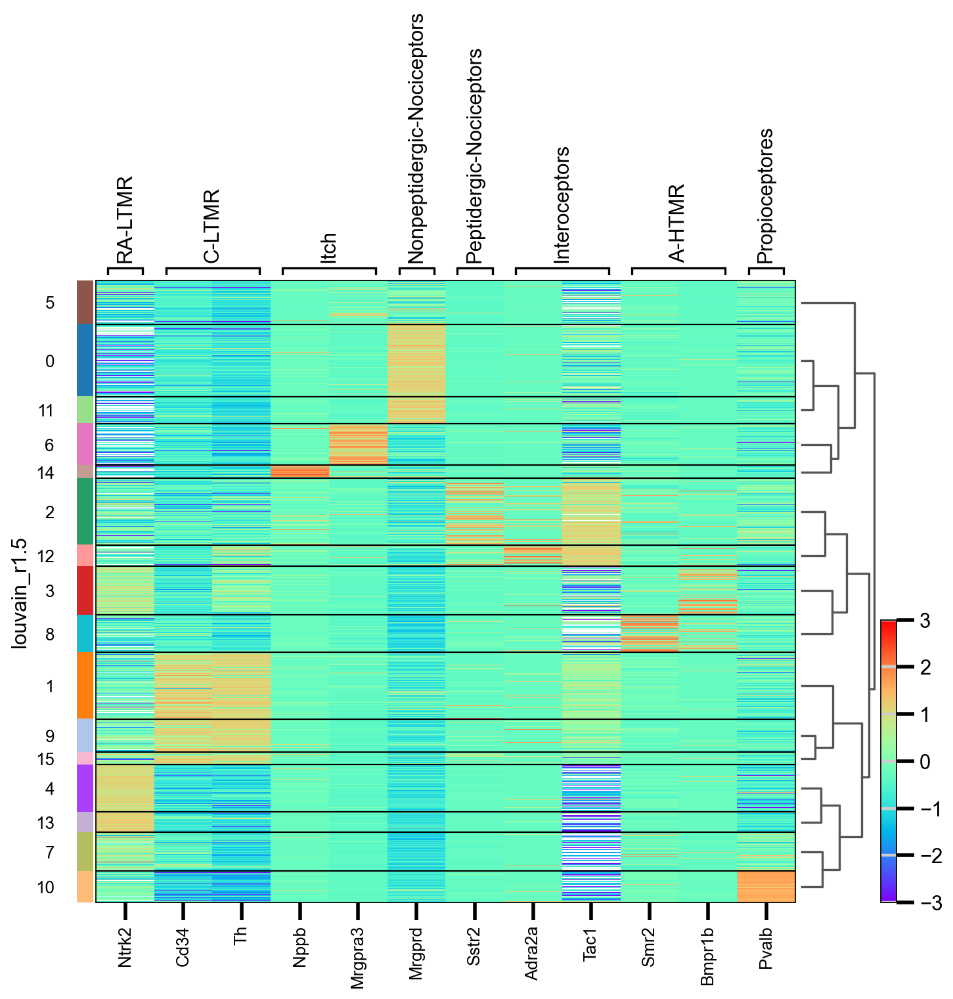

In [28]:
sc.pl.heatmap(adata_umap, marker_genes_dict, groupby=SELECTED_LOUVAIN, cmap='rainbow', use_raw=False, figsize=(10,8), 
              show=True,show_gene_labels=True, dendrogram = True,vmin=-3,vmax=3)

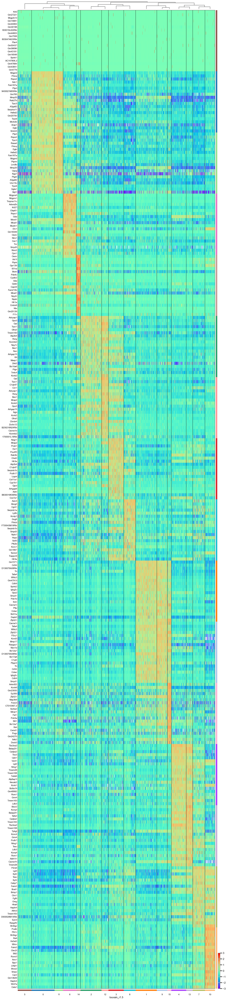

In [29]:
sc.pl.rank_genes_groups_heatmap(adata_umap, n_genes=20, use_raw=False, show_gene_labels=True,swap_axes=True, vmin=-3, vmax=3, cmap='rainbow', figsize=(20,100), show=True, dendrogram = True)